In [41]:
%matplotlib inline

#Enable reloading because restarting the kernel is a pain
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

import numpy as np
import open3d as o3d

from bot_3d_rep import *
# from bot_2d_problem import *

import copy

import pandas as pd

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [70]:
sensor_mesh = o3d.geometry.TriangleMesh.create_box(width=0.1, height=0.1, depth=0.075)
sensor_mesh.transform(TF.translation_matrix(-.05,-.05,-.05))

sensor = FOV3D(h_fov=np.radians(90), 
               v_fov=np.radians(70), 
               distance=5, 
               cost=80.00, 
               name="toy_sensor", 
               color=(0,130,170), 
               body=copy.deepcopy(sensor_mesh), 
               focal_point=(0, 0, 0))

meshes = [o3d.geometry.TriangleMesh.create_coordinate_frame(size=0.25, origin=(0,0,0))]

# TRANSFORM TESTING

# sensor.transform(TF.translation_matrix(.5,0,0))
# sensor.transform(TF.translation_matrix(0,.5,0))
# sensor.transform(TF.rotation_y_matrix(np.radians(45)))
# sensor.transform(TF.rotation_y_matrix(np.radians(45)))

sensor.transform(TF.translation_matrix(.5,.5,0))
sensor.transform(TF.translation_matrix(0,0,.5))



for m in sensor.get_viz_meshes(viz_fov=False, show_now=False):
    meshes.append(m)

o3d.visualization.draw_geometries(meshes)

Transforming sensor toy_sensor to:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]
 New TF:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]
 New focal pt:
[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]
Transforming sensor toy_sensor by the tf matrix:
[[1.  0.  0.  0.5]
 [0.  1.  0.  0.5]
 [0.  0.  1.  0. ]
 [0.  0.  0.  1. ]]
Transforming sensor toy_sensor to:
[[1.  0.  0.  0.5]
 [0.  1.  0.  0.5]
 [0.  0.  1.  0. ]
 [0.  0.  0.  1. ]]
 New TF:
[[1.  0.  0.  0.5]
 [0.  1.  0.  0.5]
 [0.  0.  1.  0. ]
 [0.  0.  0.  1. ]]
 New focal pt:
[[1.  0.  0.  0.5]
 [0.  1.  0.  0.5]
 [0.  0.  1.  0. ]
 [0.  0.  0.  1. ]]
 New TF:
[[1.  0.  0.  0.5]
 [0.  1.  0.  0.5]
 [0.  0.  1.  0. ]
 [0.  0.  0.  1. ]]
 New focal pt:
[[1.  0.  0.  0.5]
 [0.  1.  0.  0.5]
 [0.  0.  1.  0. ]
 [0.  0.  0.  1. ]]
Transforming sensor toy_sensor by the tf matrix:
[[1.  0.  0.  0. ]
 [0.  1.  0.  0. ]
 [0.  0.  1.  0.5]
 [0.  0.  0.  1. ]]
Transforming sensor toy_sensor to:
[[1

In [40]:
bot_diam = 1
bot_bounds = Polygon([(-1, -2), (-1, 2), (1, 2), (1, -2)])
sens_constraint = Polygon(Point(0, 0).buffer(bot_diam/1-.2).exterior.buffer(0.4))
sense_requirement =  Polygon(Point(0, 0).buffer(12).exterior.coords)
sense_requirement = shapely.affinity.scale(sense_requirement, xfact=2/3, yfact=1, origin=(0, 0))
sense_requirement = shapely.affinity.translate(sense_requirement, xoff=0, yoff=4)

bot_seed = SimpleBot2d(bot_bounds, sense_requirement, sensor_pose_constraint=sens_constraint)

bot_seed.add_sensors_2d([copy.deepcopy(sensor_options[0]), copy.deepcopy(sensor_options[0])])
bot_seed.sensors[0].translate(.25,0)
bot_seed.sensors[1].translate(-.25,0)

bot_seed.sensors[0].rotate(-2)
bot_seed.sensors[1].rotate(2)

bot_seed.plot_bot()
print(f"Package valid?: {bot_seed.is_valid_pkg()}")

NameError: name 'Polygon' is not defined

Largest Dimension: 16.0
Un-normalized Bounds: Bounds(array([-16., -16.,   0., -16., -16.,   0.]), array([ 16.,  16., 360.,  16.,  16., 360.]))
================== STARTING OPTIMIZATION ==================
Initial Params: [0.5078125, 0.525, 0.9944444444444445, 0.4921875, 0.525, 0.005555555555555556]
 Objective: -0.39546097066692476
 Objective: -0.3954609835025274
 Objective: -0.39546097040442474
 Objective: -0.39546095464921033
 Objective: -0.3954609578313216
 Objective: -0.39546097040442485
 Objective: -0.3954609866846374
 Constraint: -0.0
 Constraint: -0.0
 Constraint: -0.0
 Constraint: -0.0
 Constraint: -0.0
 Constraint: -0.0
 Constraint: -0.0
 Callback (norm):             status: None
               fun: -0.39546097066692476
                 x: [ 5.078e-01  5.250e-01  9.944e-01  4.922e-01  5.250e-01
                      5.556e-03]
               nit: 1
              nfev: 7
              njev: 1
              nhev: 0
          cg_niter: 0
      cg_stop_cond: 0
              grad: [-8

/Users/robosquiggles/miniforge3/envs/blenv/lib/python3.11/site-packages/scipy/optimize/_differentiable_functions.py:551: UserWarning: delta_grad == 0.0. Check if the approximated function is linear. If the function is linear better results can be obtained by defining the Hessian as zero instead of using quasi-Newton approximations.
  self.H.update(delta_x, delta_g)


 Objective: -0.5701138758236102
 Objective: -0.5701138777056863
 Objective: -0.5701138728461288
 Objective: -0.5701138766594285
 Objective: -0.570113878633329
 Objective: -0.5701138823859851
 Constraint: -0.053149603297721455
 Constraint: -0.05314915908960428
 Constraint: -0.05314882602382881
 Constraint: -0.05314960368854315
 Constraint: -0.05315004750204813
 Constraint: -0.053150380575404804
 Constraint: -0.05314959960011679
 Callback (norm):             status: None
               fun: -0.569344425628204
                 x: [ 5.093e-01  4.862e-01  8.777e-01  5.008e-01  4.800e-01
                      1.225e-01]
               nit: 51
              nfev: 357
              njev: 51
              nhev: 0
          cg_niter: 112
      cg_stop_cond: 2
              grad: [ 4.016e-01 -5.223e-02 -1.572e-01 -3.406e-01 -9.903e-02
                      9.403e-02]
   lagrangian_grad: [ 4.016e-01 -5.223e-02 -1.572e-01 -3.406e-01 -9.903e-02
                      9.403e-02]
            constr: [a

/Users/robosquiggles/miniforge3/envs/blenv/lib/python3.11/site-packages/scipy/optimize/_trustregion_constr/equality_constrained_sqp.py:217: UserWarning: Singular Jacobian matrix. Using SVD decomposition to perform the factorizations.
  Z, LS, Y = projections(A, factorization_method)


 Constraint: -0.0
 Constraint: -0.0
 Callback (norm):             status: None
               fun: -0.5707747882135099
                 x: [ 5.096e-01  4.863e-01  8.889e-01  5.044e-01  4.783e-01
                      1.352e-01]
               nit: 135
              nfev: 959
              njev: 137
              nhev: 0
          cg_niter: 529
      cg_stop_cond: 2
              grad: [ 3.074e-01 -8.801e-02 -6.625e-02 -3.294e-01 -8.430e-02
                      2.980e-02]
   lagrangian_grad: [ 3.074e-01 -8.801e-02 -6.625e-02 -3.294e-01 -8.430e-02
                      2.980e-02]
            constr: [array([-0.000e+00])]
               jac: [array([[ 0.000e+00,  0.000e+00,  0.000e+00,
                             0.000e+00,  0.000e+00,  0.000e+00]])]
       constr_nfev: [959]
       constr_njev: [0]
       constr_nhev: [0]
                 v: [array([ 0.000e+00])]
            method: tr_interior_point
        optimality: 0.32941970229148865
  constr_violation: 0.0
    execution_time: 0.

Animation size has reached 21008893 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


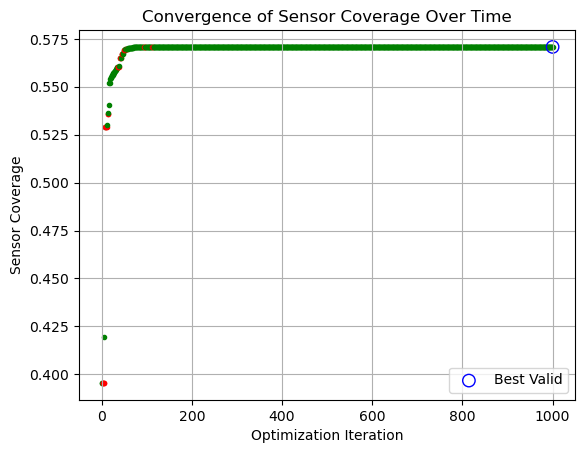

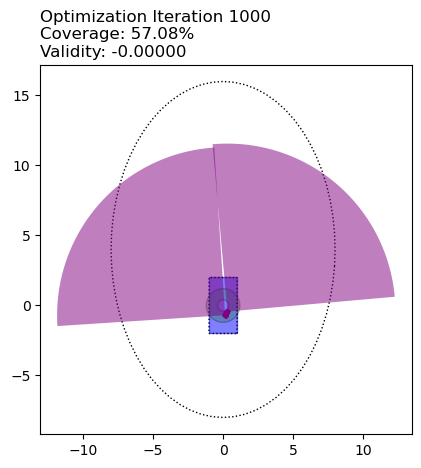

In [41]:
bot_optimize = copy.deepcopy(bot_seed)

ani = bot_optimize.optimize_sensor_placement(animate=True, plot=True, verbose=True)
HTML(ani.to_jshtml())

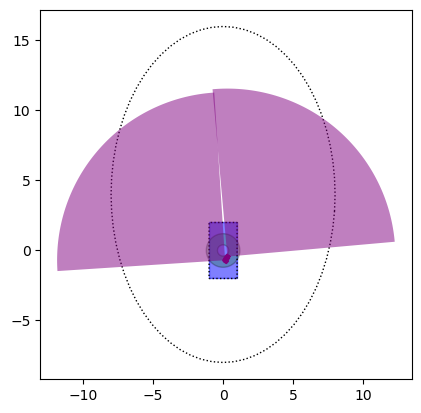

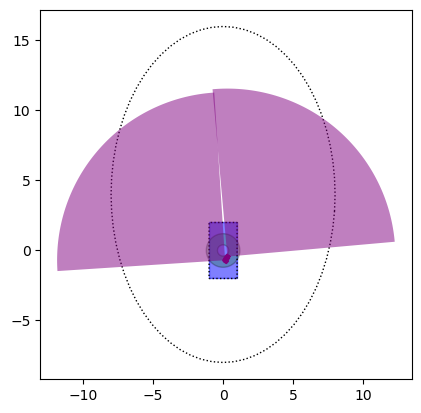

In [42]:
bot_optimize.plot_bot()